In [1]:
# General imports for data handling
import pandas as pd
import numpy as np
import joblib

# RDKit for chemical informatics
from rdkit import Chem
from rdkit.Chem import Draw, AllChem
from rdkit.Chem.Draw import rdMolDraw2D
from rdkit.Chem.Draw import IPythonConsole  # Enables RDKit's IPython integration for Jupyter notebooks.

# Scikit-learn for machine learning
from sklearn.model_selection import train_test_split

# Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display

# Miscellaneous
from PIL import Image
import io


# Set1 dataset 

In [2]:


def load_and_concatenate_datasets(file_paths):
    """
    Load datasets from given file paths and concatenate them into a single DataFrame.
    """
    dataframes = [pd.read_pickle(path) for path in file_paths]
    return pd.concat(dataframes, ignore_index=True)

def preprocess_data(df, feature_col='ecfp6', label_col='rna'):
    """
    Preprocess the DataFrame by extracting features and labels.
    """
    X = np.array([list(map(int, list(fp))) for fp in df[feature_col]])
    y = df[label_col].values
    return X, y

def stratified_train_test_split(X, y, groups, test_size=0.2, random_state=42):
    """
    Split the dataset into training and test sets, ensuring stratification of the target variable.
    """
    X_train, X_test, y_train, y_test, idx_train, idx_test = train_test_split(
        X, y, groups, test_size=test_size, random_state=random_state, stratify=y
    )
    return X_train, X_test, y_train, y_test, idx_train, idx_test

def visualize_molecules_with_highlights(molecules_df, important_bits, bit_info_map):
    """
    Visualize molecules with highlighted fragments corresponding to important bits.
    Includes SMILES string below each molecule image.
    """
    fig, axes = plt.subplots(7, 3, figsize=(20, 30))
    axes = axes.flatten()
    for ax, (_, row) in zip(axes, molecules_df.iterrows()):
        mol = Chem.MolFromSmiles(row['smiles'])
        bi = bit_info_map[row['unique_id']]
        atom_indices = set()
        bond_indices = set()
        for bit in important_bits:
            if bit in bi:
                for atom_index, radius in bi[bit]:
                    atom_indices.add(atom_index)
                    env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_index)
                    for bidx in env:
                        bond = mol.GetBondWithIdx(bidx)
                        bond_indices.add(bond.GetIdx())
        d2d = rdMolDraw2D.MolDraw2DCairo(400, 400)
        d2d.drawOptions().addAtomIndices = False
        d2d.DrawMolecule(mol, highlightAtoms=list(atom_indices), highlightBonds=list(bond_indices))
        d2d.FinishDrawing()
        im = Image.open(io.BytesIO(d2d.GetDrawingText()))
        ax.imshow(np.array(im))
        ax.axis('off')
        # Set SMILES string as the title below the molecule image
        ax.set_title(row['smiles'], fontsize=10, pad= -2)  # Adjust font size and padding as necessary
        # the title can be closer 
    plt.tight_layout()
    plt.savefig('set1_molecules_with_highlights.png', format='png', dpi=600)
    plt.savefig('set1_molecules_with_highlights.svg', format='svg', dpi=600)
    plt.show()


def extract_and_save_fragments(molecules_df, important_bits, bit_info_map):
    """
    Extract unique fragments from molecules and save to CSV file, sorted by the number of occurrences.
    Ensure only non-empty fragments are counted.
    """
    fragment_counts = {}
    for _, row in molecules_df.iterrows():
        mol = Chem.MolFromSmiles(row['smiles'])
        bi = bit_info_map[row['unique_id']]
        for bit in important_bits:
            if bit in bi:
                for atom_index, radius in bi[bit]:
                    env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_index)
                    submol = Chem.PathToSubmol(mol, env)
                    if submol:
                        sub_smiles = Chem.MolToSmiles(submol, canonical=True)
                        if sub_smiles:  # Check if sub_smiles is not empty
                            if sub_smiles in fragment_counts:
                                fragment_counts[sub_smiles] += 1
                            else:
                                fragment_counts[sub_smiles] = 1

    df = pd.DataFrame(list(fragment_counts.items()), columns=['Fragment_SMILES', 'Occurrences'])
    df = df.sort_values(by='Occurrences', ascending=False)
    df.to_csv('set1_fragment_library.csv', index=False)




In [3]:

# Load and preprocess data
file_paths = ['../data_for_ml/all_ml_df.pkl']
combined_df = load_and_concatenate_datasets(file_paths)
combined_df['unique_id'] = combined_df.index
X, y = preprocess_data(combined_df)
X_train, X_test, y_train, y_test, idx_train, idx_test = stratified_train_test_split(
    X, y, combined_df['unique_id'].values
)

# Load model and feature importances
feature_importances = pd.read_csv('../a_results_ml_set1/ml_output/output/sample_008/features/feature_importances_XGBoost_008.csv')
best_model = joblib.load('../a_results_ml_set1/ml_output/output/sample_008/models/best_xgb.joblib')

# Apply model to test data
predicted_probabilities = best_model.predict_proba(X_test)[:, 1]
combined_df.loc[idx_test, 'predicted_proba'] = predicted_probabilities

# Select high probability molecules
high_proba_molecules = combined_df[combined_df['predicted_proba'] > 0.8]
# important_bits = feature_importances['Feature'].head(30).str.extract('(\d+)').astype(int)[0].tolist()
# load important bits which have importance higher than 0.002
important_bits = feature_importances[feature_importances['Importance'] > 0.002]['Feature'].str.extract('(\d+)').astype(int)[0].tolist()

bit_info_map = combined_df.set_index('unique_id')['bit_info_map'].to_dict()

Set1: Best XGBoost with the highest accuracy is from run 8 with an accuracy of 0.8904675794368381.


In [4]:
X_train.shape, X_test.shape

((61936, 2048), (15484, 2048))

In [5]:
# from predicted probabilities, show number in positive and negative class
combined_df.loc[idx_test, 'predicted_class'] = best_model.predict(X_test)
combined_df.loc[idx_test, 'predicted_class'].value_counts()


predicted_class
0.0    7793
1.0    7691
Name: count, dtype: int64

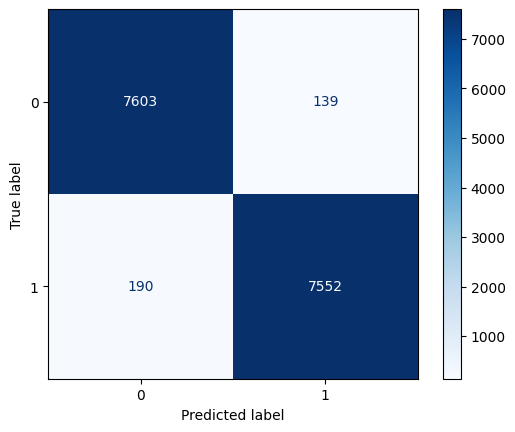

In [6]:
# visualize the confusion matrix
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, best_model.predict(X_test))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_model.classes_)
disp.plot(cmap='Blues')
plt.show()

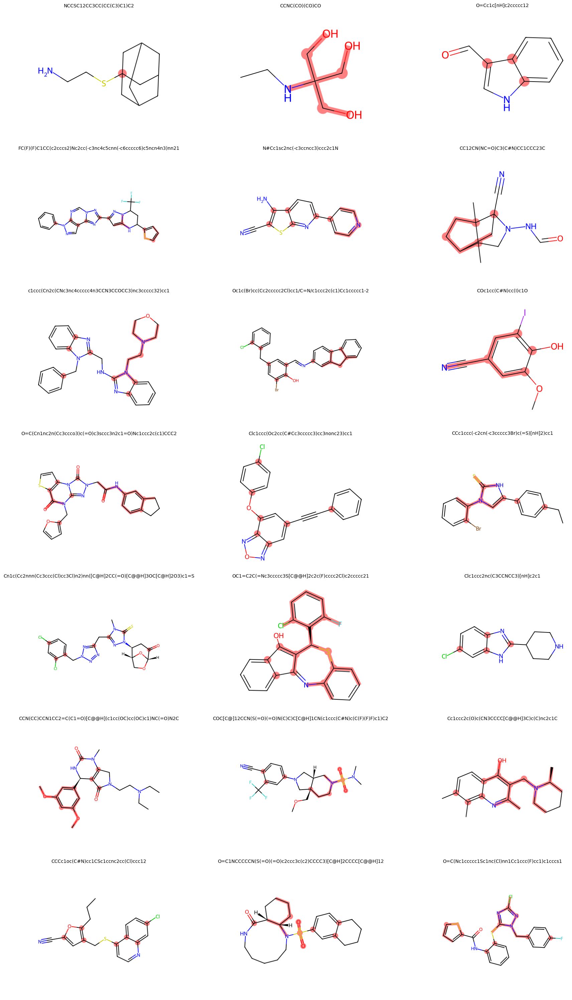

In [7]:


# Visualize and extract fragments
visualize_molecules_with_highlights(high_proba_molecules, important_bits, bit_info_map)


In [8]:
extract_and_save_fragments(high_proba_molecules, important_bits, bit_info_map)


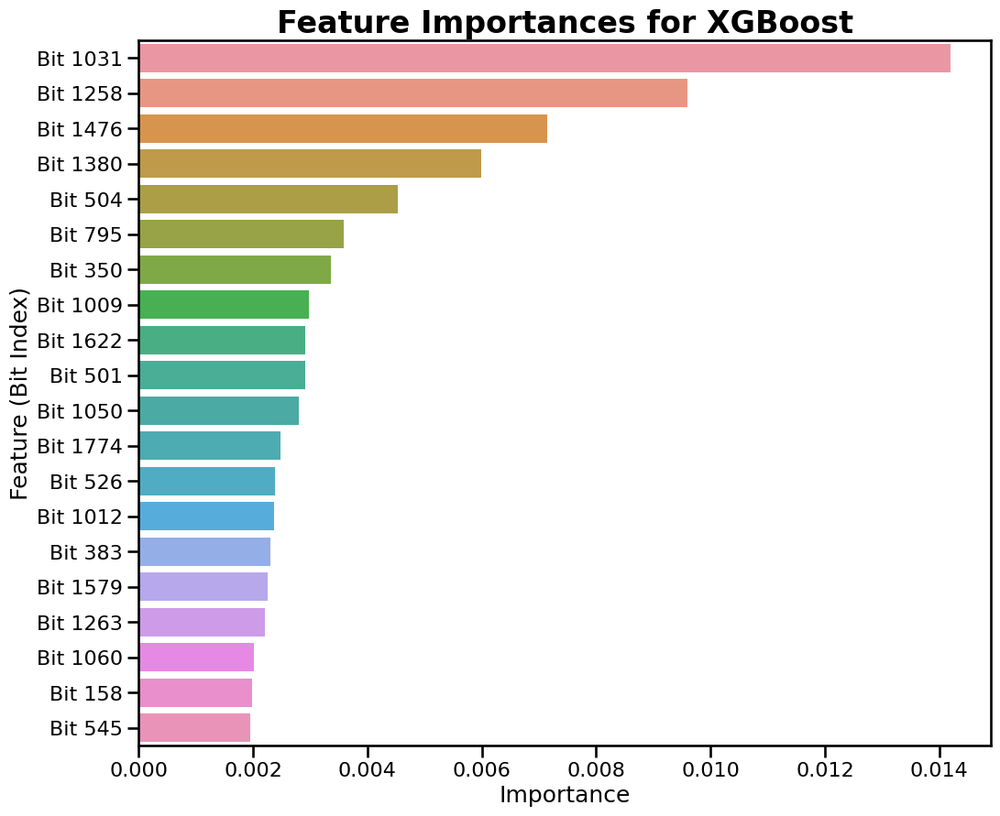

In [10]:
def plot_feature_importances(feature_names, feature_importances, title='Feature Importances', n_features=20):
    """
    Visualize the top N feature importances (above a specified threshold) for interpretability.
    """
    # Create a DataFrame from feature names and importances
    data = pd.DataFrame({
        'Feature': feature_names,
        'Importance': feature_importances
    })
    
    # Filter data for importances greater than the threshold
    filtered_data = data[data['Importance'] > 0.0015]
    
    # Sort the data by importance in descending order and select the top N features
    filtered_data = filtered_data.sort_values(by='Importance', ascending=False).head(n_features)
    
    # Set the seaborn theme to 'talk'
    sns.set_context('talk')
    
    # Plotting
    plt.figure(figsize=(12, 10))
    sns.barplot(x='Importance', y='Feature', data=filtered_data, orient='h')
    
    # Customize the plot for a poster
    plt.title(title, fontsize=24, weight='bold')
    plt.xlabel('Importance', fontsize=18)
    plt.ylabel('Feature (Bit Index)', fontsize=18)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    
    # Save the figure
    plt.savefig('set1_feature_importances.svg', format='svg', dpi=300)
    plt.show()

# Example usage:
plot_feature_importances(feature_importances['Feature'], feature_importances['Importance'], 'Feature Importances for XGBoost', 20)

In [10]:
# load fragment library
fragment_library = pd.read_csv('set1_fragment_library.csv')
fragment_library.head()

,Fragment_SMILES,Occurrences
0,cc(n)=O,1109
1,CC(N)=O,946
2,O=S,542
3,cnc(c(c)n)n(c)C,495
4,ccc(cc)C(N)=O,395


[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic
[23:14:25] non-ring atom 6 marked aromatic
[23:14:25] non-ring atom 0 marked aromatic


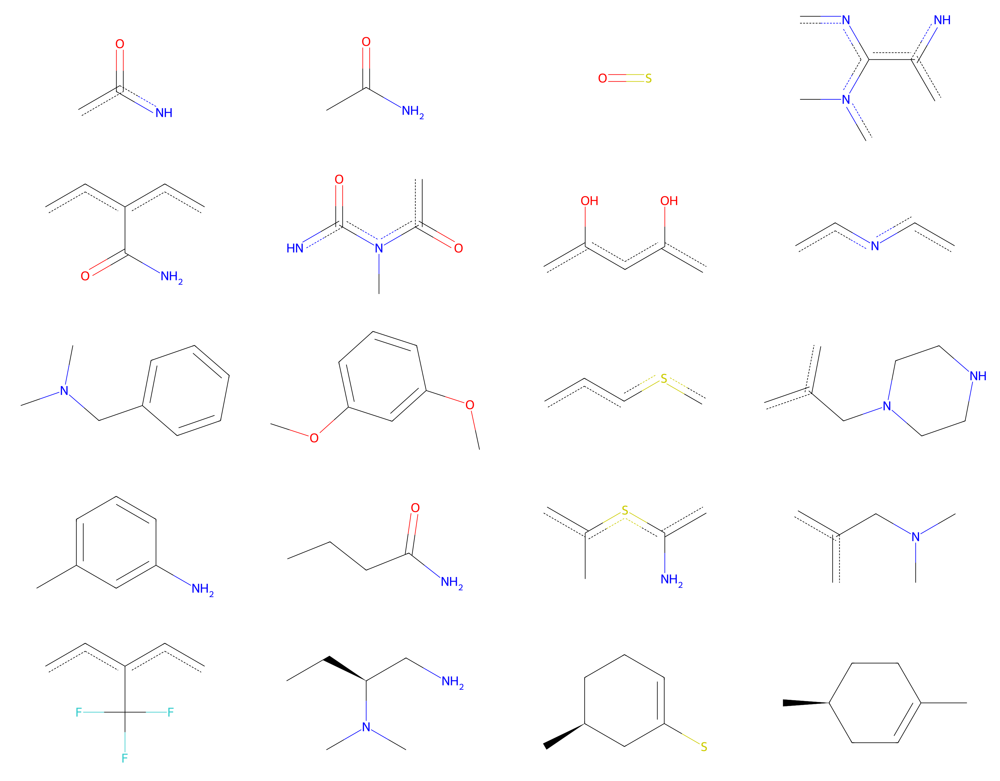

In [12]:

# Load the CSV file
fragment_library = pd.read_csv('set1_fragment_library.csv')

# Extract the top 50 SMILES strings and their occurrences
smiles = fragment_library[['Fragment_SMILES', 'Occurrences']].head(20)

# Convert SMILES to RDKit Molecule objects as fragments
molecules = []
legends = []
failed_smiles = []

for idx, row in smiles.iterrows():
    smi = row['Fragment_SMILES']
    occ = row['Occurrences']
    if smi is not None:
        try:
            # Create molecule without sanitization
            mol = Chem.MolFromSmiles(smi, sanitize=False)
            if mol:
                # Attempt to sanitize the molecule here but catch any failures
                try:
                    Chem.SanitizeMol(mol, sanitizeOps=Chem.SanitizeFlags.SANITIZE_FINDRADICALS |
                                                     Chem.SanitizeFlags.SANITIZE_KEKULIZE |
                                                     Chem.SanitizeFlags.SANITIZE_SETAROMATICITY |
                                                     Chem.SanitizeFlags.SANITIZE_ADJUSTHS)
                except:
                    pass  # If sanitization fails, we still keep the molecule
                molecules.append(mol)
                legends.append(f"Occ: {occ}")
            else:
                failed_smiles.append((occ, smi))
        except Exception as e:
            failed_smiles.append((occ, smi))
            print(f"Failed to process SMILES '{smi}' with occurrences {occ}. Error: {str(e)}")

# Draw the molecules if any valid molecules were created
if molecules:
    img = Draw.MolsToGridImage(molecules, returnPNG=False, molsPerRow=4, subImgSize=(800, 500), legends=False)
    # Display the image (if running in a Jupyter notebook or similar environment)
    display(img)
    # Save the image to a file with 600 dpi
    img.save('set1_fragments_occ.png', 'PNG', dpi=(300, 300))
else:
    print("No valid molecules could be displayed.")

# Optionally, print out which SMILES failed and why
if failed_smiles:
    print("Failed SMILES strings:")
    # for occ, smi in failed_smiles:
        # print(f"Occurrences {occ}, SMILES: {smi}")


In [ ]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import rdMolDraw2D
from IPython.display import SVG, display

# Load the CSV file
fragment_library = pd.read_csv('set1_fragment_library.csv')

# Extract the top 20 SMILES strings and their occurrences
smiles = fragment_library[['Fragment_SMILES', 'Occurrences']].head(20)

# Convert SMILES to RDKit Molecule objects as fragments
molecules = []
legends = []
failed_smiles = []

for idx, row in smiles.iterrows():
    smi = row['Fragment_SMILES']
    occ = row['Occurrences']
    if smi is not None:
        try:
            # Create molecule without sanitization
            mol = Chem.MolFromSmiles(smi, sanitize=False)
            if mol:
                # Attempt to sanitize the molecule here but catch any failures
                try:
                    Chem.SanitizeMol(mol, sanitizeOps=Chem.SanitizeFlags.SANITIZE_FINDRADICALS |
                                                     Chem.SanitizeFlags.SANITIZE_KEKULIZE |
                                                     Chem.SanitizeFlags.SANITIZE_SETAROMATICITY |
                                                     Chem.SanitizeFlags.SANITIZE_ADJUSTHS)
                except:
                    pass  # If sanitization fails, we still keep the molecule
                molecules.append(mol)
                legends.append(f"Occ: {occ}")
            else:
                failed_smiles.append((occ, smi))
        except Exception as e:
            failed_smiles.append((occ, smi))
            print(f"Failed to process SMILES '{smi}' with occurrences {occ}. Error: {str(e)}")

# Draw the molecules if any valid molecules were created
if molecules:
    # Create a MolDraw2DSVG object
    d2d = rdMolDraw2D.MolDraw2DSVG(800, 500 * len(molecules) // 4)
    d2d.drawOptions().addAtomIndices = False
    
    for mol in molecules:
        rdMolDraw2D.PrepareAndDrawMolecule(d2d, mol)
    
    d2d.FinishDrawing()
    svg = d2d.GetDrawingText().replace('svg:', '')
    
    # Display the SVG in a Jupyter notebook
    display(SVG(svg))
    
    # Save the SVG to a file
    with open('set1_fragments_occ.svg', 'w') as f:
        f.write(svg)
else:
    print("No valid molecules could be displayed.")

# Optionally, print out which SMILES failed and why
if failed_smiles:
    print("Failed SMILES strings:")
    for occ, smi in failed_smiles:
        print(f"Occurrences {occ}, SMILES: {smi}")


In [ ]:
import os
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import rdMolDraw2D
from IPython.display import SVG, display

# Load the CSV file
fragment_library = pd.read_csv('set1_fragment_library.csv')

# Extract the top 20 SMILES strings and their occurrences
smiles = fragment_library[['Fragment_SMILES', 'Occurrences']].head(20)

# Create a directory to save the fragments if it doesn't exist
output_dir = 'fragments'
os.makedirs(output_dir, exist_ok=True)

# Convert SMILES to RDKit Molecule objects as fragments
molecules = []
legends = []
failed_smiles = []

for idx, row in smiles.iterrows():
    smi = row['Fragment_SMILES']
    occ = row['Occurrences']
    if smi is not None:
        try:
            # Create molecule without sanitization
            mol = Chem.MolFromSmiles(smi, sanitize=False)
            if mol:
                # Attempt to sanitize the molecule here but catch any failures
                try:
                    Chem.SanitizeMol(mol, sanitizeOps=Chem.SanitizeFlags.SANITIZE_FINDRADICALS |
                                                     Chem.SanitizeFlags.SANITIZE_KEKULIZE |
                                                     Chem.SanitizeFlags.SANITIZE_SETAROMATICITY |
                                                     Chem.SanitizeFlags.SANITIZE_ADJUSTHS)
                except:
                    pass  # If sanitization fails, we still keep the molecule
                molecules.append(mol)
                legends.append(f"Occ: {occ}")
            else:
                failed_smiles.append((occ, smi))
        except Exception as e:
            failed_smiles.append((occ, smi))
            print(f"Failed to process SMILES '{smi}' with occurrences {occ}. Error: {str(e)}")

# Save each molecule as an individual SVG file
for i, mol in enumerate(molecules):
    d2d = rdMolDraw2D.MolDraw2DSVG(300, 300)
    d2d.drawOptions().addAtomIndices = False
    rdMolDraw2D.PrepareAndDrawMolecule(d2d, mol)
    d2d.FinishDrawing()
    svg = d2d.GetDrawingText().replace('svg:', '')

    # Save the SVG to a file in the fragments directory
    with open(f'{output_dir}/fragment_{i+1}.svg', 'w') as f:
        f.write(svg)

    # Optionally display in a Jupyter notebook
    display(SVG(svg))

if not molecules:
    print("No valid molecules could be displayed.")

# Optionally, print out which SMILES failed and why
if failed_smiles:
    print("Failed SMILES strings:")
    for occ, smi in failed_smiles:
        print(f"Occurrences {occ}, SMILES: {smi}")


[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic
[23:19:18] non-ring atom 6 marked aromatic
[23:19:18] non-ring atom 0 marked aromatic


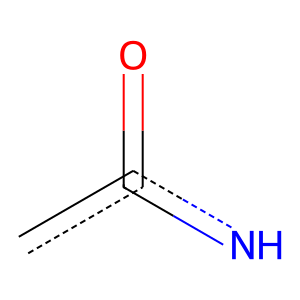

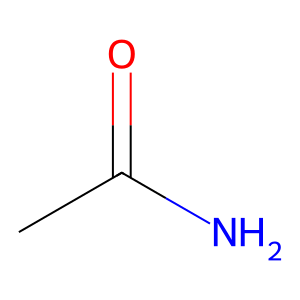

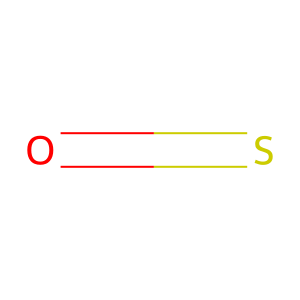

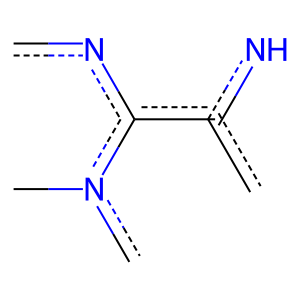

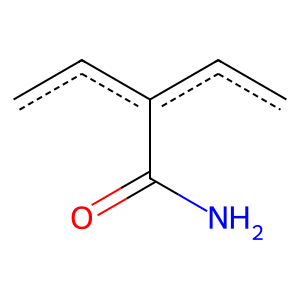

...

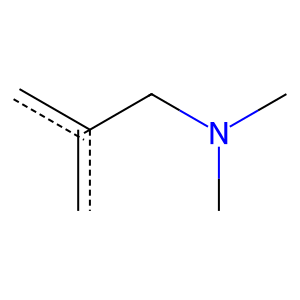

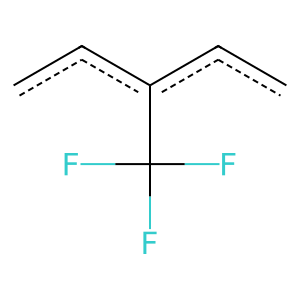

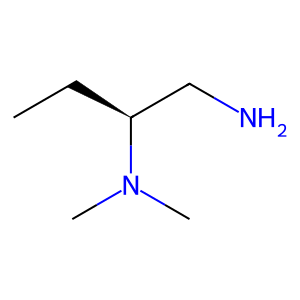

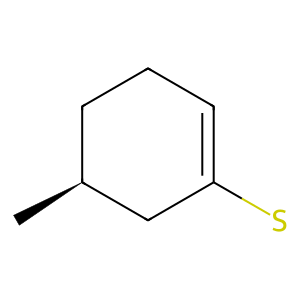

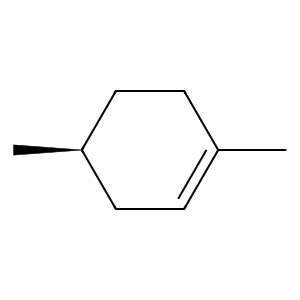

In [16]:
import os
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import rdMolDraw2D
from IPython.display import SVG, display

# Load the CSV file
fragment_library = pd.read_csv('set1_fragment_library.csv')

# Extract the top 20 SMILES strings and their occurrences
smiles = fragment_library[['Fragment_SMILES', 'Occurrences']].head(20)

# Create a directory to save the fragments if it doesn't exist
output_dir = 'fragments_nobackground'
os.makedirs(output_dir, exist_ok=True)

# Convert SMILES to RDKit Molecule objects as fragments
molecules = []
legends = []
failed_smiles = []

for idx, row in smiles.iterrows():
    smi = row['Fragment_SMILES']
    occ = row['Occurrences']
    if smi is not None:
        try:
            # Create molecule without sanitization
            mol = Chem.MolFromSmiles(smi, sanitize=False)
            if mol:
                # Attempt to sanitize the molecule here but catch any failures
                try:
                    Chem.SanitizeMol(mol, sanitizeOps=Chem.SanitizeFlags.SANITIZE_FINDRADICALS |
                                                     Chem.SanitizeFlags.SANITIZE_KEKULIZE |
                                                     Chem.SanitizeFlags.SANITIZE_SETAROMATICITY |
                                                     Chem.SanitizeFlags.SANITIZE_ADJUSTHS)
                except:
                    pass  # If sanitization fails, we still keep the molecule
                molecules.append(mol)
                legends.append(f"Occ: {occ}")
            else:
                failed_smiles.append((occ, smi))
        except Exception as e:
            failed_smiles.append((occ, smi))
            print(f"Failed to process SMILES '{smi}' with occurrences {occ}. Error: {str(e)}")

# Save each molecule as an individual SVG file without background
for i, mol in enumerate(molecules):
    d2d = rdMolDraw2D.MolDraw2DSVG(300, 300)
    d2d.drawOptions().clearBackground = False  # Disable background
    d2d.drawOptions().addAtomIndices = False
    rdMolDraw2D.PrepareAndDrawMolecule(d2d, mol)
    d2d.FinishDrawing()
    svg = d2d.GetDrawingText().replace('svg:', '')

    # Save the SVG to a file in the fragments directory
    with open(f'{output_dir}/fragment_{i+1}.svg', 'w') as f:
        f.write(svg)

    # Optionally display in a Jupyter notebook
    display(SVG(svg))

if not molecules:
    print("No valid molecules could be displayed.")

# Optionally, print out which SMILES failed and why
if failed_smiles:
    print("Failed SMILES strings:")
    for occ, smi in failed_smiles:
        print(f"Occurrences {occ}, SMILES: {smi}")


In [45]:

# to 4 decimal places

fragment_stats = fragment_stats.round({'Frequency': 4, 'Predicted_Proba': 4})
# save the fragment statistics
fragment_stats.to_csv('set1_fragment_stats.csv', index=False)
fragment_stats.head(20)

,Fragment_SMILES,Occurrences,Frequency,Predicted_Proba
0,cc(n)=O,1109,0.1253,0.9899
1,CC(N)=O,946,0.1069,0.9843
2,O=S,542,0.0612,0.9481
3,cc1ncnc1n(c)C,491,0.0555,0.9960
4,ccc(cc)C(N)=O,395,0.0446,0.9827
5,cc(=O)n(C)c(n)=O,376,0.0425,0.9936
6,cc(O)cc(c)O,314,0.0355,0.9943
7,ccncc,313,0.0354,0.9846
8,CN(C)Cc1ccccc1,277,0.0313,0.9905
9,COc1cccc(OC)c1,268,0.0303,0.9941


## Analysis and Visualization of Molecular Fragments Influencing RNA Binding
### Feature Importance Determination

In the quest to unravel the molecular determinants that differentiate RNA-binding ligands from protein-binding counterparts, we employed a Random Forest classifier trained on Extended-Connectivity Fingerprints (ECFP6) with 2048 bits representation. The choice of ECFP6 was motivated by its proven effectiveness in capturing the essence of molecular topology which is critical for understanding ligand-binding specificity. Upon training, we conducted a feature importance analysis which illuminated the specific bits of the ECFP6 that were most influential in the classification decision-making process.

The feature importance distribution, observed to be right-skewed, suggested that a substantial number of fingerprint bits contributed minimally to the predictive model, while a select few exhibited substantial influence. This imbalance underscores the existence of certain substructural features within the ligands that are particularly indicative of their propensity to bind RNA over proteins.

### Visualization of Important Molecular Features

Following the statistical analysis, we selected the top-ranking features based on a cumulative importance threshold, ensuring a focus on the most predictive elements of the ligands. These bits were reverse-engineered to their corresponding molecular fragments, allowing us to visually highlight these crucial substructures directly on the molecular canvases. Utilizing RDKit's cheminformatics tools, we rendered images of high-probability RNA-binding ligands from our test set, emphasizing the important fragments with high predictive confidence.

This visualization serves not only as a vivid illustration of the theoretical predictions but also aids in the qualitative assessment of the model. By showcasing these fragments, we delineate the putative 'hot spots' within the molecules that may be instrumental for RNA interaction, offering a tangible guide for future molecular design and hypothesis generation.

### Fragment Library Construction

The practical culmination of this analysis was the assembly of a fragment library, a compilation of unique chemical motifs recurrent among the RNA-binding ligands with high model confidence. This library stands as a testament to the predictive power of the computational approach employed and forms a resource of immediate utility for the scientific community. Researchers can leverage this fragment library for virtual screening, de novo drug design, or as a benchmark for experimental validation studies.

### Importance and Implications

The significance of this analysis is multifold. It validates the capability of machine learning models to discriminate between RNA and protein binders based on molecular fingerprints, reaffirming the robustness of ECFP6 for ligand classification tasks. Moreover, the identification and visualization of important fragments provide an interpretable means to rationalize the model's predictions, bridging the gap between computational predictions and chemical intuition.

The fragment library is a cornerstone for subsequent structure-activity relationship studies, enabling the scientific community to explore the chemical space of RNA-binding ligands with precision. It has the potential to accelerate the discovery of novel RNA-targeting therapeutics, offering a scaffold upon which to build more potent and selective agents.

In conclusion, this computational exploration elucidates the defining features of RNA-binding ligands, offering both a detailed molecular understanding and a practical toolkit for advancing RNA-targeted drug discovery endeavors.


# Set2 model2 RNA-binders ROBIN vs Protein Binders 

In [46]:


def load_and_concatenate_datasets(file_paths):
    """
    Load datasets from given file paths and concatenate them into a single DataFrame.
    """
    dataframes = [pd.read_pickle(path) for path in file_paths]
    return pd.concat(dataframes, ignore_index=True)

def preprocess_data(df, feature_col='ecfp6', label_col='label'):
    """
    Preprocess the DataFrame by extracting features and labels.
    """
    X = np.array([list(map(int, list(fp))) for fp in df[feature_col]])
    y = df[label_col].values
    return X, y

def stratified_train_test_split(X, y, groups, test_size=0.2, random_state=42):
    """
    Split the dataset into training and test sets, ensuring stratification of the target variable.
    """
    X_train, X_test, y_train, y_test, idx_train, idx_test = train_test_split(
        X, y, groups, test_size=test_size, random_state=random_state, stratify=y
    )
    return X_train, X_test, y_train, y_test, idx_train, idx_test

def visualize_molecules_with_highlights(molecules_df, important_bits, bit_info_map):
    """
    Visualize molecules with highlighted fragments corresponding to important bits.
    Includes SMILES string below each molecule image.
    """
    fig, axes = plt.subplots(7, 3, figsize=(20, 30))
    axes = axes.flatten()
    for ax, (_, row) in zip(axes, molecules_df.iterrows()):
        mol = Chem.MolFromSmiles(row['smiles'])
        bi = bit_info_map[row['unique_id']]
        atom_indices = set()
        bond_indices = set()
        for bit in important_bits:
            if bit in bi:
                for atom_index, radius in bi[bit]:
                    atom_indices.add(atom_index)
                    env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_index)
                    for bidx in env:
                        bond = mol.GetBondWithIdx(bidx)
                        bond_indices.add(bond.GetIdx())
        d2d = rdMolDraw2D.MolDraw2DCairo(400, 400)
        d2d.drawOptions().addAtomIndices = False
        d2d.DrawMolecule(mol, highlightAtoms=list(atom_indices), highlightBonds=list(bond_indices))
        d2d.FinishDrawing()
        im = Image.open(io.BytesIO(d2d.GetDrawingText()))
        ax.imshow(np.array(im))
        ax.axis('off')
        # Set SMILES string as the title below the molecule image
        ax.set_title(row['smiles'], fontsize=12, pad=2)  # Adjust font size and padding as necessary
        # the title can be closer 
    plt.tight_layout()
    plt.savefig('set2_molecules_with_highlights.png', format='png', dpi=600)
    plt.savefig('set2_molecules_with_highlights.svg', format='svg', dpi=600)
    plt.show()


def extract_and_save_fragments(molecules_df, important_bits, bit_info_map):
    """
    Extract unique fragments from molecules and save to CSV file, sorted by the number of occurrences.
    Ensure only non-empty fragments are counted.
    """
    fragment_counts = {}
    for _, row in molecules_df.iterrows():
        mol = Chem.MolFromSmiles(row['smiles'])
        bi = bit_info_map[row['unique_id']]
        for bit in important_bits:
            if bit in bi:
                for atom_index, radius in bi[bit]:
                    env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_index)
                    submol = Chem.PathToSubmol(mol, env)
                    if submol:
                        sub_smiles = Chem.MolToSmiles(submol, canonical=True)
                        if sub_smiles:  # Check if sub_smiles is not empty
                            if sub_smiles in fragment_counts:
                                fragment_counts[sub_smiles] += 1
                            else:
                                fragment_counts[sub_smiles] = 1

    df = pd.DataFrame(list(fragment_counts.items()), columns=['Fragment_SMILES', 'Occurrences'])
    df = df.sort_values(by='Occurrences', ascending=False)
    df.to_csv('set2_fragment_library.csv', index=False)




In [47]:

# Load and preprocess data
file_paths = ['../data_for_ml/ml_datasets_set2/model2_rna_bin_protein_bin/data.pkl']
combined_df = load_and_concatenate_datasets(file_paths)
combined_df['unique_id'] = combined_df.index
X, y = preprocess_data(combined_df)
X_train, X_test, y_train, y_test, idx_train, idx_test = stratified_train_test_split(
    X, y, combined_df['unique_id'].values
)

# Load model and feature importances
feature_importances = pd.read_csv('../ml/model2_rna_prot_bin/output/sample_001/features/feature_importances_LightGBM_001.csv')
best_model = joblib.load('../ml/model2_rna_prot_bin/output/sample_001/models/best_lgb.joblib')

# Apply model to test data
predicted_probabilities = best_model.predict_proba(X_test)[:, 1]
combined_df.loc[idx_test, 'predicted_proba'] = predicted_probabilities

# Select high probability molecules
high_proba_molecules = combined_df[combined_df['predicted_proba'] > 0.8]
# important_bits = feature_importances['Feature'].head(30).str.extract('(\d+)').astype(int)[0].tolist()
# load important bits which have importance higher than 0.002
important_bits = feature_importances[feature_importances['Importance'] > 0.002]['Feature'].str.extract('(\d+)').astype(int)[0].tolist()

bit_info_map = combined_df.set_index('unique_id')['bit_info_map'].to_dict()

Set2 model2: Best Random Forest with the highest accuracy is from run 3 with an accuracy of 0.9418457648546144.


In [48]:
X_train.shape, X_test.shape

((3137, 2048), (785, 2048))

In [49]:
# from predicted probabilities, show number in positive and negative class
combined_df.loc[idx_test, 'predicted_class'] = best_model.predict(X_test)
combined_df.loc[idx_test, 'predicted_class'].value_counts()


predicted_class
0.0    396
1.0    389
Name: count, dtype: int64

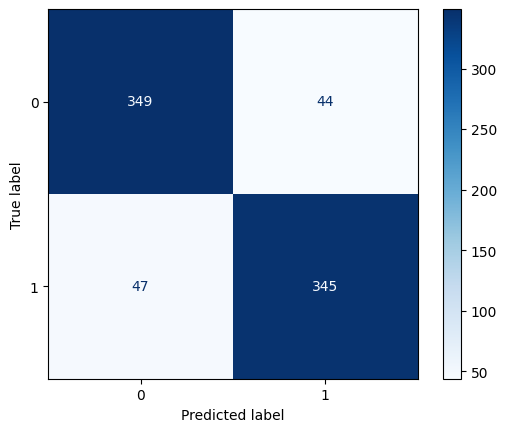

In [50]:
# visualize the confusion matrix
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, best_model.predict(X_test))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_model.classes_)
disp.plot(cmap='Blues')
plt.show()

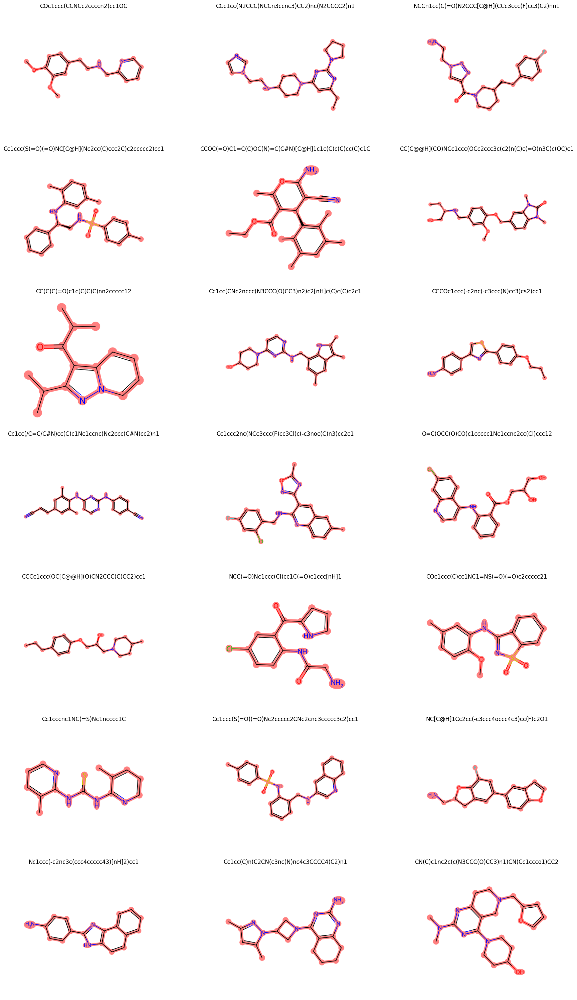

In [51]:


# Visualize and extract fragments
visualize_molecules_with_highlights(high_proba_molecules, important_bits, bit_info_map)


In [52]:
extract_and_save_fragments(high_proba_molecules, important_bits, bit_info_map)


In [53]:

def plot_feature_importances(feature_names, feature_importances, title='Feature Importances', n_features=20):
    """
    Visualize the top N feature importances (above a specified threshold) for interpretability.
    """
    # Create a DataFrame from feature names and importances
    data = pd.DataFrame({
        'Feature': feature_names,
        'Importance': feature_importances
    })
    
    # Filter data for importances greater than the threshold
    filtered_data = data[data['Importance'] > 0.0015]
    
    # Sort the data by importance in descending order and select the top N features
    filtered_data = filtered_data.sort_values(by='Importance', ascending=False).head(n_features)
    
    # Plotting
    plt.figure(figsize=(10, 8))
    sns.barplot(x='Importance', y='Feature', data=filtered_data, orient='h')
    plt.title(title)
    plt.xlabel('Importance')
    plt.ylabel('Feature (Bit Index)')
    plt.savefig('set2_feature_importances.png', format='png', dpi=600)
    plt.show()


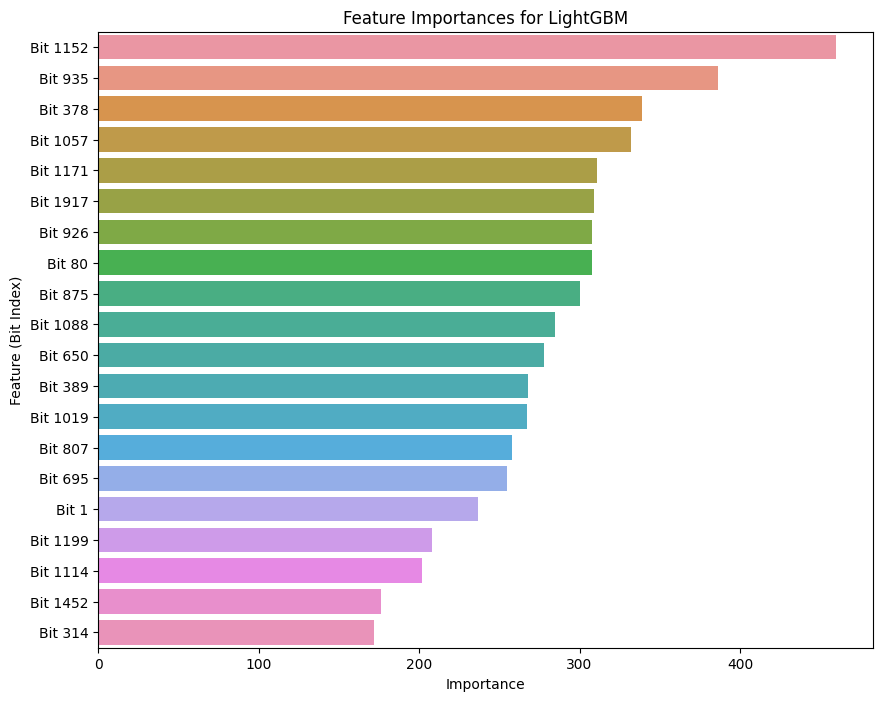

In [54]:
# Example usage:
plot_feature_importances(feature_importances['Feature'], feature_importances['Importance'], 'Feature Importances for LightGBM', n_features=20)

In [55]:
# load fragment library
fragment_library = pd.read_csv('set2_fragment_library.csv')
fragment_library.head()

,Fragment_SMILES,Occurrences
0,ccc,2031
1,ccccc,479
2,CCN,429
3,CCC,391
4,cc(c)C,370


[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic
[14:55:22] non-ring atom 0 marked aromatic


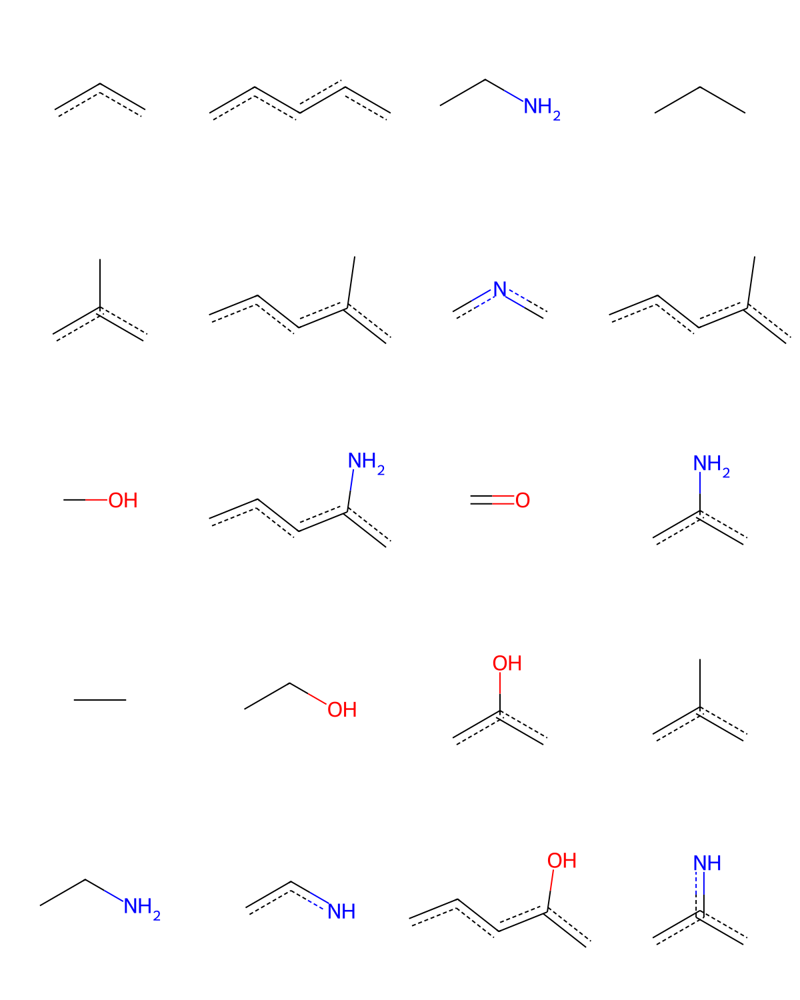

In [56]:

# Load the CSV file
fragment_library = pd.read_csv('set2_fragment_library.csv')

# Extract the top 50 SMILES strings and their occurrences
smiles = fragment_library[['Fragment_SMILES', 'Occurrences']].head(20)

# Convert SMILES to RDKit Molecule objects as fragments
molecules = []
legends = []
failed_smiles = []

for idx, row in smiles.iterrows():
    smi = row['Fragment_SMILES']
    occ = row['Occurrences']
    if smi is not None:
        try:
            # Create molecule without sanitization
            mol = Chem.MolFromSmiles(smi, sanitize=False)
            if mol:
                # Attempt to sanitize the molecule here but catch any failures
                try:
                    Chem.SanitizeMol(mol, sanitizeOps=Chem.SanitizeFlags.SANITIZE_FINDRADICALS |
                                                     Chem.SanitizeFlags.SANITIZE_KEKULIZE |
                                                     Chem.SanitizeFlags.SANITIZE_SETAROMATICITY |
                                                     Chem.SanitizeFlags.SANITIZE_ADJUSTHS)
                except:
                    pass  # If sanitization fails, we still keep the molecule
                molecules.append(mol)
                legends.append(f"Occ: {occ}")
            else:
                failed_smiles.append((occ, smi))
        except Exception as e:
            failed_smiles.append((occ, smi))
            print(f"Failed to process SMILES '{smi}' with occurrences {occ}. Error: {str(e)}")

# Draw the molecules if any valid molecules were created
if molecules:
    img = Draw.MolsToGridImage(molecules, returnPNG=False, molsPerRow=4, subImgSize=(300, 300), legends=False)
    # Display the image (if running in a Jupyter notebook or similar environment)
    display(img)
    # Save the image to a file with 600 dpi
    img.save('set2_fragments_occ.png', 'PNG', dpi=(600, 600))
else:
    print("No valid molecules could be displayed.")

# Optionally, print out which SMILES failed and why
if failed_smiles:
    print("Failed SMILES strings:")
    # for occ, smi in failed_smiles:
        # print(f"Occurrences {occ}, SMILES: {smi}")


In [57]:
fragments = pd.read_csv('set2_fragment_library.csv')


def map_bits_to_fragments(mol, bit_info, important_bits):
    """
    Map the important bits to the corresponding fragments in the molecule, with enhanced error handling.
    """
    fragments = []
    for bit in important_bits:
        if bit in bit_info:
            for atom_index, radius in bit_info[bit]:
                env = Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom_index)
                if env:  # Ensure the environment is not empty
                    amap = {}
                    submol = Chem.PathToSubmol(mol, env, atomMap=amap)
                    if submol and amap:
                        frag = Chem.MolFragmentToSmiles(mol, list(amap.keys()), canonical=True)
                        if frag:
                            fragments.append(frag)
                    else:
                        print(f"Warning: No valid submolecule could be created for bit {bit} with atom index {atom_index} and radius {radius}.")
                else:
                    print(f"Warning: Empty environment for bit {bit} with atom index {atom_index} and radius {radius}.")
        else:
            print(f"Warning: Bit {bit} not found in bit_info for this molecule.")
    return fragments

# List to hold the data before creating DataFrame
fragment_data = []

for _, row in high_proba_molecules.iterrows():
    mol = Chem.MolFromSmiles(row['smiles'])
    molecule_id = row['unique_id']
    predicted_proba = row['predicted_proba']
    bit_info = bit_info_map.get(molecule_id, {})
    fragments = map_bits_to_fragments(mol, bit_info, important_bits)
    
    # Collect each fragment's data
    for frag in fragments:
        fragment_data.append({
            'Molecule_ID': molecule_id,
            'Fragment_SMILES': frag,
            'Predicted_Proba': predicted_proba
        })

# Convert list of dictionaries to DataFrame
molecule_fragments = pd.DataFrame(fragment_data)

# Calculate the frequency of each fragment.
fragment_library = molecule_fragments['Fragment_SMILES'].value_counts().reset_index()
fragment_library.columns = ['Fragment_SMILES', 'Occurrences']
fragment_library['Frequency'] = fragment_library['Occurrences'] / fragment_library['Occurrences'].sum()

# Calculate the average predictive probability for each fragment.
fragments_proba = molecule_fragments.groupby('Fragment_SMILES')['Predicted_Proba'].mean().reset_index()

# Merge with the fragment library to get the statistics for each fragment.
fragment_stats = pd.merge(fragment_library, fragments_proba, on='Fragment_SMILES', how='left')


In [58]:
fragment_stats = fragment_stats.round({'Frequency': 4, 'Predicted_Proba': 4})
# save fragment stats to csv
fragment_stats.to_csv('set2_fragment_stats.csv', index=False)
fragment_stats.head(20)

,Fragment_SMILES,Occurrences,Frequency,Predicted_Proba
0,ccc,2031,0.1171,0.9899
1,ccccc,479,0.0276,0.9910
2,CCN,429,0.0247,0.9881
3,CCC,387,0.0223,0.9885
4,cc(c)C,313,0.0180,0.9906
5,cnc,295,0.0170,0.9902
6,cccc(c)C,260,0.0150,0.9904
7,cC,180,0.0104,0.9940
8,c-c(c)ccc,173,0.0100,0.9937
9,CO,169,0.0097,0.9889
